# Step 1. A simple noisy linear dataset.

(a) Choose values for wtrue and for btrue from a uniform distribution over [-2,2]

In [1]:
import numpy as np

In [2]:
n = 20

In [3]:
def chooseParams():
    w_true = np.random.uniform(-2,2)
    b_true = np.random.uniform(-2,2)
    return(w_true, b_true)

w_true, b_true = chooseParams()
print(f"Random value of w_true = \n{w_true}")
print(f"Random value of b_true = \n{b_true}")

Random value of w_true = 
1.0444763840727052
Random value of b_true = 
-1.1506202016089593


---

(b) Generate Noisy Linear Data

In [4]:
def generateNoisyLinearData(n, xLo, xHi, w, b, noiseType, sigma):
    x = np.random.uniform(xLo, xHi, n)
    
    if(noiseType == "uniform"):
        noise = np.random.uniform(-2,2,n)
    elif(noiseType == "gaussian"):
        noise = np.random.normal(0,sigma,n)
        
    y_true = w * x + b + noise
    
    return x, y_true        

In [5]:
x_gaussian, y_true_gaussian = generateNoisyLinearData(n, -1, 1, w_true, b_true, "gaussian", 1)
print(f"Noisy Linear Data X for gaussian NoiseType \n{x_gaussian}\n")
print(f"Noisy Linear Data Y for gaussian NoiseType \n{y_true_gaussian}")

Noisy Linear Data X for gaussian NoiseType 
[-0.38033395  0.93641489 -0.19212258 -0.29082168 -0.03096493 -0.17780937
 -0.07846535  0.25786457 -0.48395596  0.8130666  -0.04030767  0.70162264
  0.31536357 -0.28103959  0.21452926 -0.18170073  0.0010196  -0.98627228
 -0.63442977  0.95506661]

Noisy Linear Data Y for gaussian NoiseType 
[-0.62634837 -1.10628372 -2.67786288 -1.69099309  0.23967749  0.78041828
 -0.95048497 -0.22228094 -1.3362024  -0.46508838 -2.28302665  0.28566631
 -1.63283097 -0.37486602 -0.16268339 -1.02395177 -0.4200639  -2.52957117
 -2.42950002  0.84954082]


In [6]:
x_uniform, y_true_uniform = generateNoisyLinearData(n, -1, 1, w_true, b_true, "uniform", 1)
print(f"Noisy Linear Data X for uniform NoiseType \n{x_uniform}\n")
print(f"Noisy Linear Data Y for uniform NoiseType \n{y_true_uniform}")

Noisy Linear Data X for uniform NoiseType 
[ 0.71238513 -0.02477035 -0.36069857  0.80723883  0.39598499  0.07762956
  0.58543935  0.14167743  0.08513292  0.74350145  0.25884583 -0.60452511
  0.94597346 -0.34940293  0.70694559  0.36169085  0.04248621  0.151058
  0.56664813 -0.9474204 ]

Noisy Linear Data Y for uniform NoiseType 
[ 1.47699746 -1.43322894 -3.28268183  0.59097224 -1.62367403 -2.35546819
 -1.1681006  -1.31151415 -1.36725962 -0.26403266 -1.83308959 -0.83536688
  1.14065766 -2.01675939 -0.47794413 -2.19172111 -2.00892452  0.60161851
 -0.41977383 -2.89355618]


---

(c) Plot Linear Data

In [7]:
import matplotlib.pyplot as plt
%matplotlib inline 

In [8]:
def plotLinearData(X, Y):
    plt.title("Linear Data Plot")
    plt.xlabel("X-axis")
    plt.ylabel("Y-axis")
    plt.scatter(X,Y)
    plt.show()

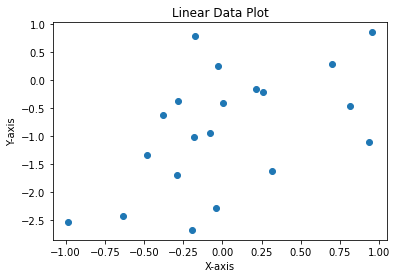

In [9]:
plotLinearData(x_gaussian, y_true_gaussian)

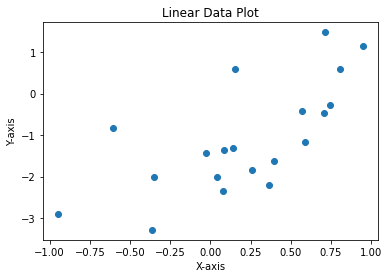

In [10]:
plotLinearData(x_uniform, y_true_uniform)

---

# Step 2. Evaluating a Prediction of the Linear Function

(a) Calculate loss for a single data point

In [11]:
def loss(w,b,x,ytrue,lossType):
    y_estimate = w * x + b
    if(lossType == 0):
        loss = y_estimate - ytrue
    elif(lossType == 1):
        loss = (y_estimate - ytrue)**2
    return loss

In [12]:
#Absolute loss
loss(w_true,b_true,x_gaussian[0],y_true_gaussian[0],0)

-0.9215216606113528

In [13]:
#Square loss
loss(w_true,b_true,x_gaussian[0],y_true_gaussian[0],1)

0.8492021709759052

---

(b) Calculate average loss for all data points

In [14]:
def cost(w,b,x,y):
    loss_absolute = 0
    loss_square = 0
    
    for i in range(n):
        loss_absolute = loss_absolute + loss(w,b,x[i],y[i],0)
        loss_square = loss_square + loss(w,b,x[i],y[i],1)
        
    return loss_absolute/n, loss_square/n

In [15]:
cost(w_true, b_true, x_gaussian, y_true_gaussian)

(-0.23897602583828864, 0.8446270446864336)

---

(c) Plot costs for a given dataset

In [16]:
b_cost = 0
w_cost = np.random.uniform(-2,2,n)

In [17]:
cost_absolute_array = []
cost_square_array = []
for i in range(n):
    cost_square_array.append(cost(w_cost[i], b_cost, x_gaussian, y_true_gaussian)[1])
    cost_absolute_array.append(cost(w_cost[i], b_cost, x_gaussian, y_true_gaussian)[0])
cost_square_array = np.array(cost_square_array)
cost_absolute_array = np.array(cost_absolute_array)

In [18]:
cost_square_array

array([2.51816518, 1.6633842 , 1.99469998, 1.66611662, 1.75599106,
       1.76323424, 1.73345261, 2.081442  , 3.38014944, 1.63113503,
       2.96366116, 2.67862286, 1.82595846, 1.62008805, 3.20680995,
       3.51883175, 1.64613924, 2.29756015, 2.73152822, 2.52695935])

In [19]:
cost_absolute_array

array([0.8701777 , 0.91998063, 0.88455237, 0.92025255, 0.92678951,
       0.9272028 , 0.89631333, 0.88167696, 0.85393105, 0.91573322,
       0.86111418, 0.86669842, 0.89132224, 0.91269112, 0.85680455,
       0.85173252, 0.91803002, 0.8755158 , 0.86560983, 0.86997934])

In [20]:
def plotCostData(X, Y, plotType):
    plt.xlabel("X_w")
    plt.ylabel("Y_costs")
    plt.title(f"Cost for a given dataset_LossType\n{plotType}")
    plt.scatter(X,Y)
    plt.show()

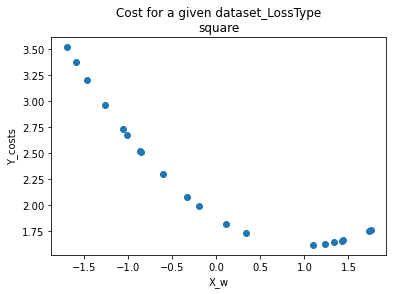

In [21]:
plotCostData(w_cost, cost_square_array, "square")

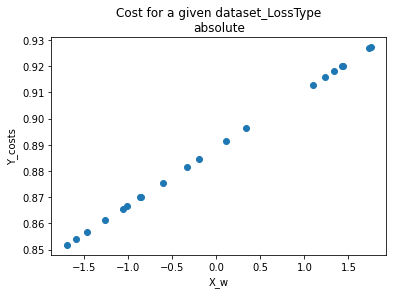

In [22]:
plotCostData(w_cost, cost_absolute_array, "absolute")

---

(d) Generating various noisy linear datasets. For a given dataset, what determines the value of the lowest loss?

In [23]:
# Noisy dataset 1
n = 20
x, ytrue = generateNoisyLinearData(n, 0, 10, w_true, b_true, "gaussian", 1)

In [24]:
# Noisy dataset 2
x, ytrue = generateNoisyLinearData(n, 0, 10, w_true, b_true, "uniform", 1)

In [25]:
# Noisy dataset 3
x, ytrue = generateNoisyLinearData(n, 0, 10, w_true, b_true, "gaussian", 1)

In [26]:
# when wtrue = 1 and btrue = 1

wtrue = 1
btrue = 1

In [27]:
cost(wtrue, btrue, x, ytrue)

(1.8500363010981602, 4.11859550199954)

In [28]:
wtrue = 1
btrue = 2

In [29]:
cost(wtrue, btrue, x, ytrue)

(2.85003630109816, 8.81866810419586)

<b>i.e.,  very less change in numbers when b is changed</b>

In [30]:
wtrue = 2
btrue = 1

In [31]:
cost(wtrue, btrue, x, ytrue)

(7.498770739067052, 65.58340749420132)

<b>i.e.,  major change in numbers when w is changed</b>

<b>Therefore, w value determines the value of lowest loss: lower the w value, lower the loss cost.</b>

---

# Step 3. The Loss Surface

(a) 3D plot of the cost as a function of w and b

In [32]:
b_cost = np.linspace(-2,2,n)
w_cost = np.linspace(-5,5,n)

X, Y = np.meshgrid(w_cost, b_cost)

cost_value = cost(X, Y, x_gaussian, y_true_gaussian)[1]

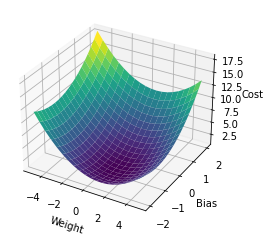

In [33]:
fig = plt.figure()
ax = fig.add_subplot(projection = '3d')
ax.set_xlabel('Weight')
ax.set_ylabel('Bias')
ax.set_zlabel('Cost')
ax.plot_surface(X, Y, cost_value, label="Loss surface", cmap='viridis',  edgecolor='none')
plt.show()

(b) Produce a contour plot using matplotlib based on the above plot

<a list of 6 text.Text objects>

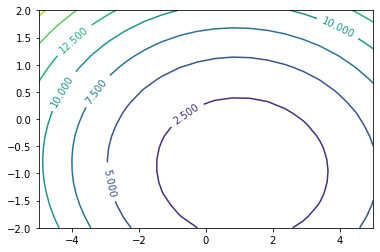

In [34]:
fig, ax = plt.subplots()
contour_plot = ax.contour(X, Y, cost_value)
ax.clabel(contour_plot, contour_plot.levels, inline = True)

(c) Values of w and b that minimize the cost function

<b>The cost function is minimum at centre point of the lowest ring, i.e approximately w = 0.5 and b = -1.0</b>

---

# Step 4. Solving the Optimization Directly

(a) optimal b analytically in terms of xi’s and yi’s where w = 0

In [35]:
# USING LINEAR ALGEBRA

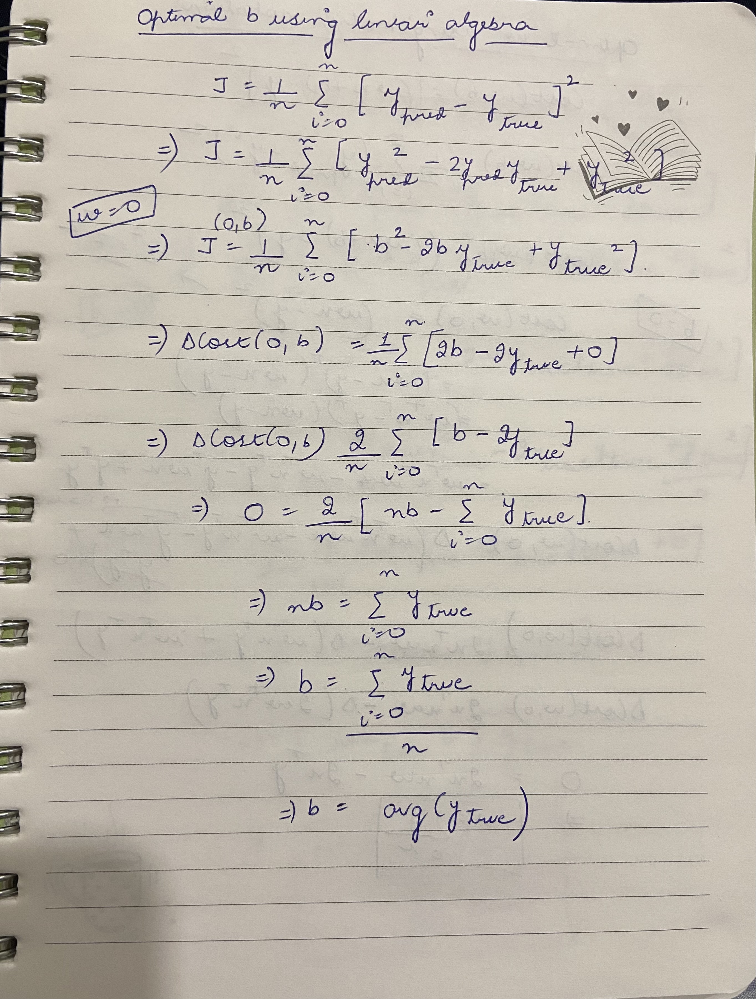

In [36]:
# USING MATRIX NOTATION

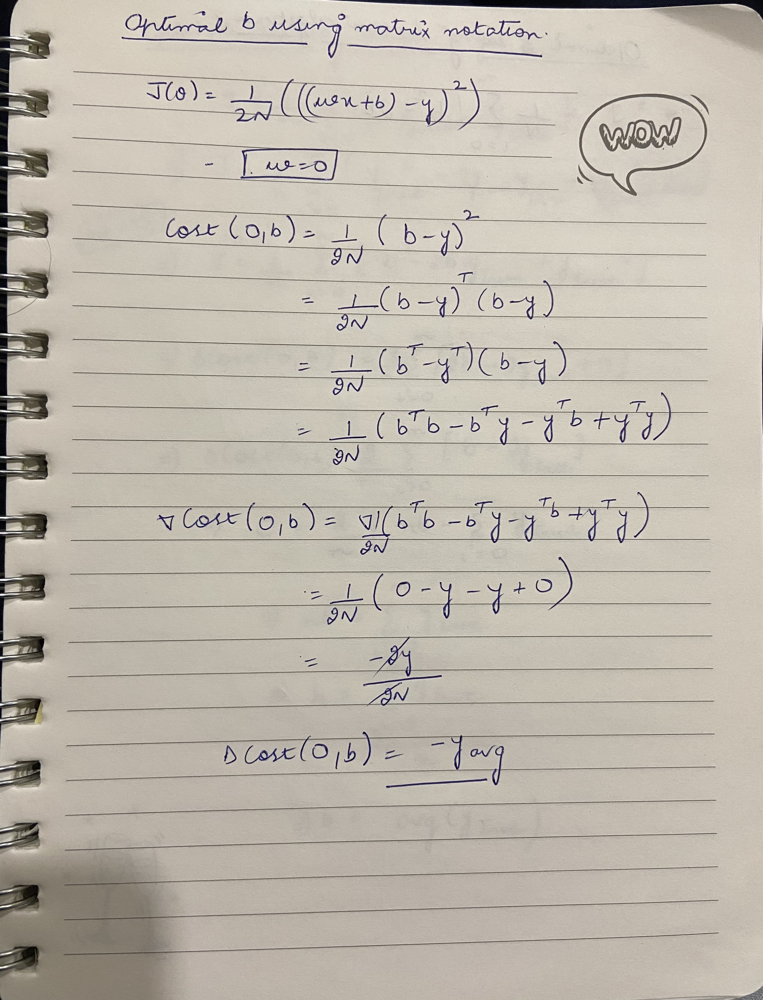

(b) optimal w analytically in terms of xi’s and yi’s where b = 0

In [37]:
# USING LINEAR ALGEBRA

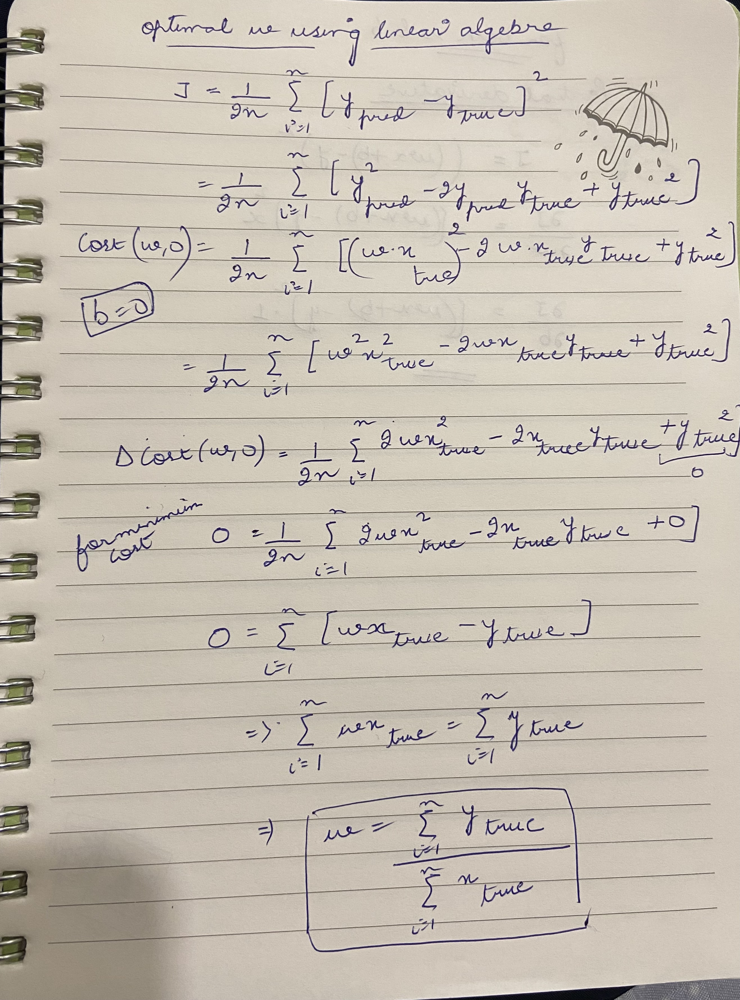

In [38]:
# USING MATRIX NOTATION

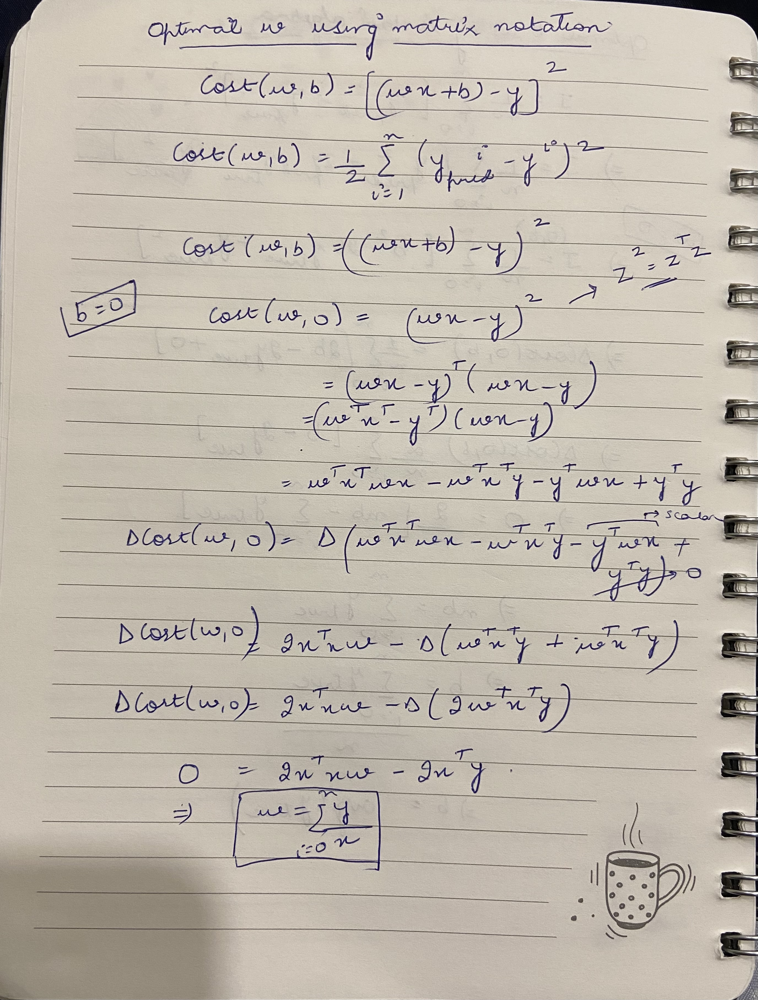

(c) w, b = argminw,b Cost(w,b), in terms of xi’s and yi’s

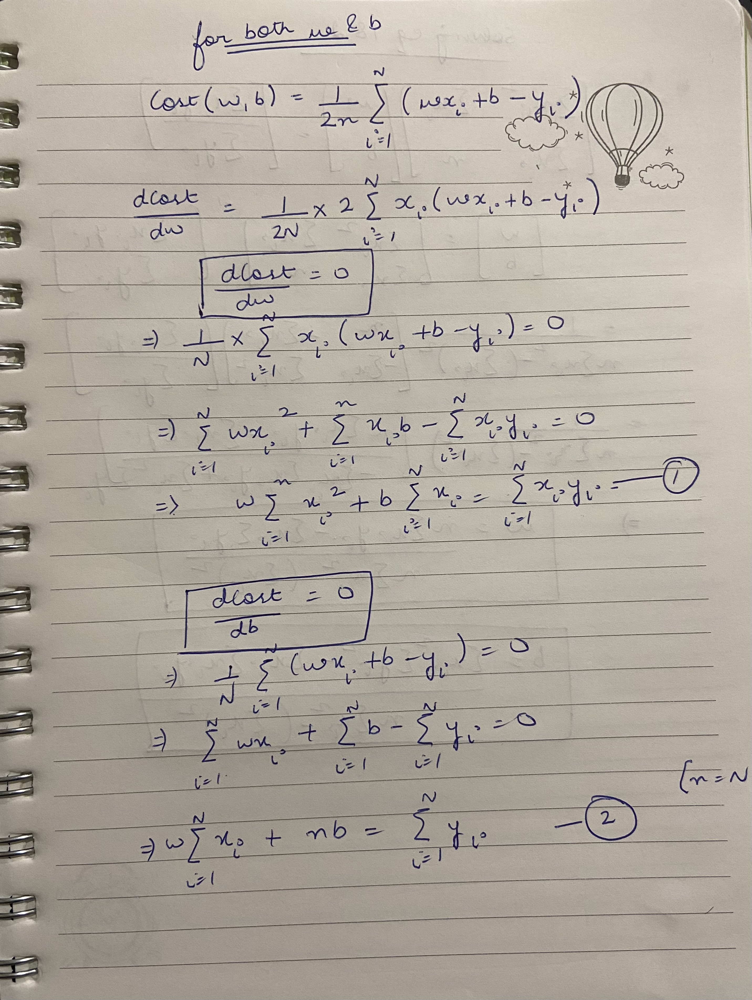

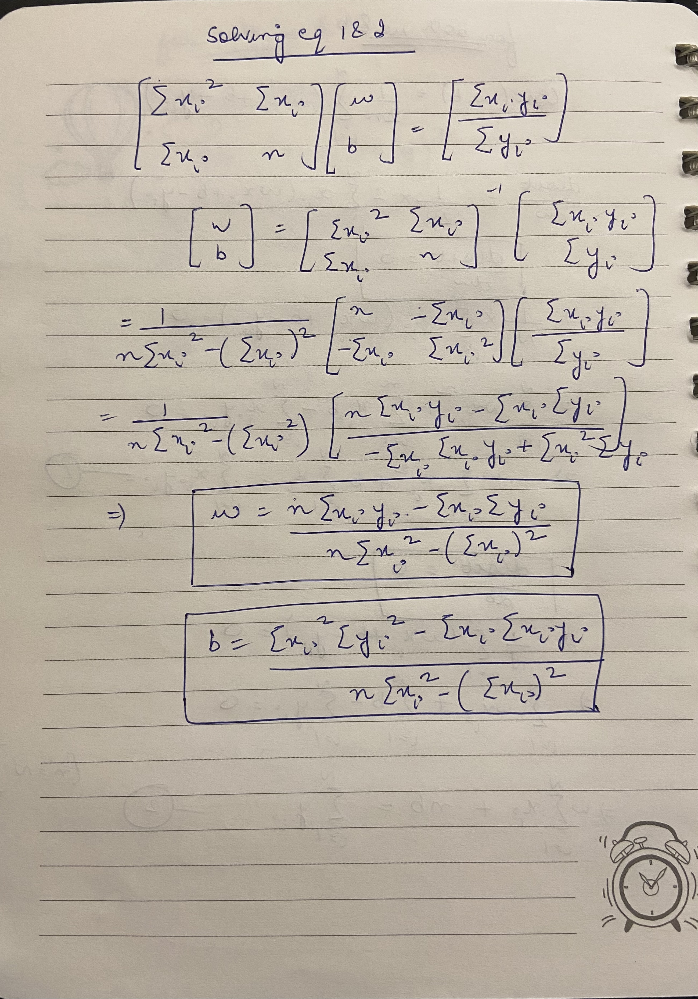

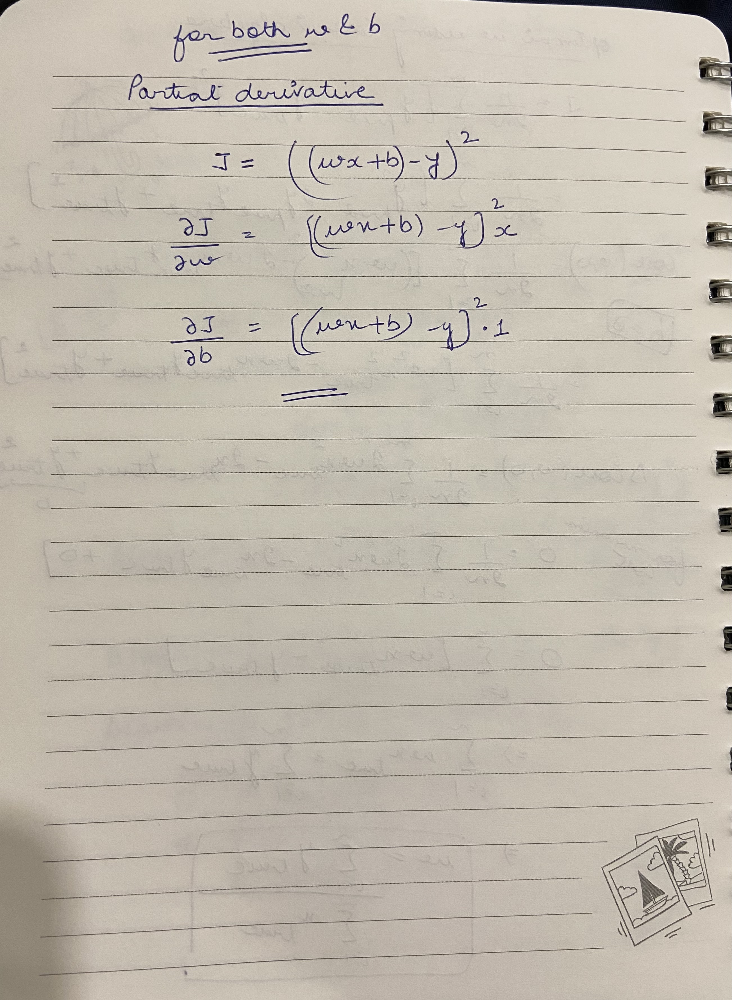

---

# Step 5. Computing the Gradient of the Loss Function

(a) Analytical expressions for the partial derivatives of the cost function with respect to both w and b

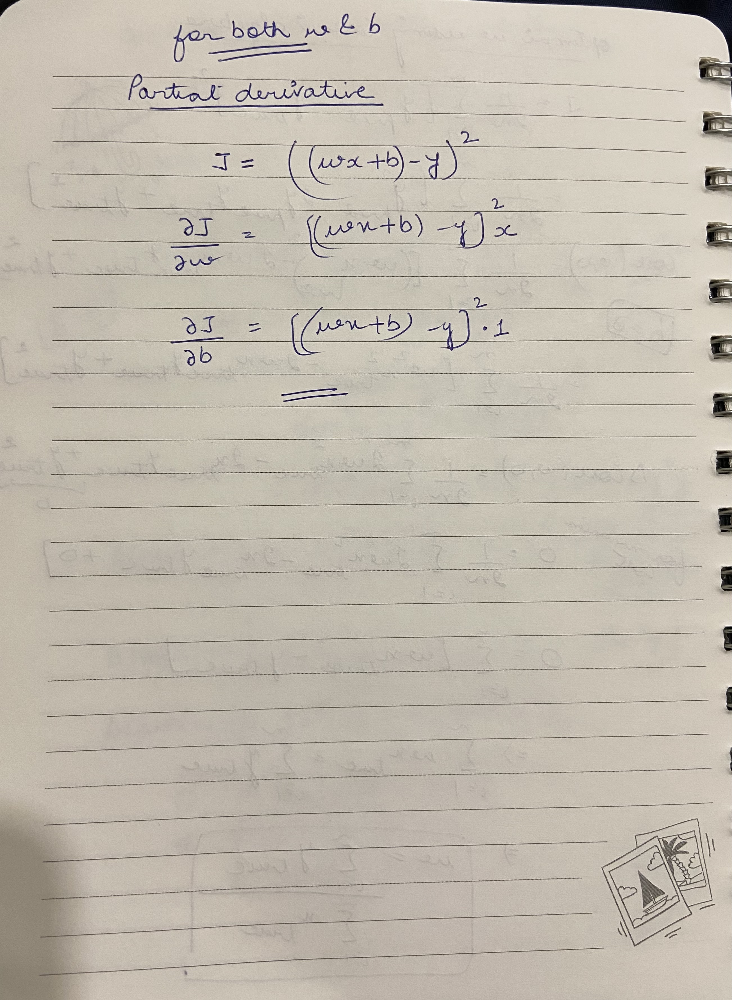

(b) partial derivatives of the cost function with respect to w and b respectively using python

In [39]:
def computeDeriv_dC_dw(w,b,X,Y):
    w_gradient = 0
    for i in range(n):
        w_gradient = w_gradient + np.dot((w * X[i] + b - Y[i]), X[i])
    return w_gradient/n

In [40]:
def computeDeriv_dC_db(b,w,X,Y):
    b_gradient = 0
    for i in range(n):
        b_gradient = b_gradient +  np.dot((w * X[i] + b - Y[i]), 1)
    return b_gradient/n

In [41]:
for i in range(n):
    w_gradient_compute = computeDeriv_dC_dw(w_true, b_true, x_gaussian, y_true_gaussian)
    b_gradient_compute = computeDeriv_dC_db(b_true, w_true, x_gaussian, y_true_gaussian)
    
    w_true = w_true - w_gradient_compute
    b_true = b_true - b_gradient_compute
    
    cost_function_value = cost(w_true, b_true, x_gaussian, y_true_gaussian)[1]
    
    print(f"w: {w_true}\nb: {b_true}\ncost_function_value: {cost_function_value}\n")

w: 1.0604264705561697
b: -0.9116441757706706
cost_function_value: 0.7872410789133918

w: 1.0670253285378304
b: -0.9119924649618477
cost_function_value: 0.7871650505116045

w: 1.0719219308726382
b: -0.912136558908392
cost_function_value: 0.7871232582243525

w: 1.0755528981363627
b: -0.9122434820694967
cost_function_value: 0.7871002781381472

w: 1.0782453632837012
b: -0.9123227685769889
cost_function_value: 0.7870876422094425

w: 1.0802419025084729
b: -0.9123815617697036
cost_function_value: 0.7870806941635209

w: 1.0817223929356166
b: -0.9124251585885967
cost_function_value: 0.7870768736812079

w: 1.0828202185518976
b: -0.9124574868655594
cost_function_value: 0.7870747729344267

w: 1.0836342873642764
b: -0.9124814591992733
cost_function_value: 0.7870736178087967

w: 1.0842379424634647
b: -0.9124992353642188
cost_function_value: 0.7870729826464666

w: 1.0846855698301383
b: -0.912512416894392
cost_function_value: 0.7870726333933848

w: 1.0850174982105405
b: -0.9125221913726463
cost_functi

(c) Partial derivatives for optimal w and b

In [42]:
y_sum = 0
x_sum = 0
for i in range(n):
    y_sum = y_sum + y_true_gaussian[i]
    x_sum = x_sum + x_gaussian[i]
b_optimal = y_sum / n
w_optimal = (y_sum / x_sum) / n

print(f"b_optimal: {b_optimal}")
print(f"w_optimal: {w_optimal}")

b_optimal: -0.8888367862690958
w_optimal: -2.0352373788526865


In [43]:
print(computeDeriv_dC_dw(w_optimal, b_optimal, x_gaussian, y_true_gaussian))
print(computeDeriv_dC_db(b_optimal, w_optimal, x_gaussian, y_true_gaussian))

-0.8082327711866688
-0.04444183931345467


---

# Step 6: Implement Gradient Descent to Solve the Noisy Linear System

In [44]:
def updateParams(w,b,X,Y,alpha,epochs):
    cost_array = []
    w_array = []
    b_array = []
    for i in range(epochs):
        w_gradient_compute = alpha * computeDeriv_dC_dw(w, b, X, Y)
        b_gradient_compute = alpha * computeDeriv_dC_db(b, w, X, Y)

        w = w - w_gradient_compute
        b = b - b_gradient_compute

        cost_array.append(cost(w, b, X, Y)[1])
        w_array.append(w)
        b_array.append(b)
    return w_array, b_array, cost_array

In [45]:
w_true = 5
b_true = 3
w, b, c = updateParams(w_true, b_true, x_gaussian, y_true_gaussian,0.01,1000)

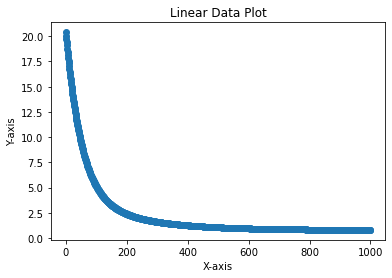

In [46]:
plotLinearData(np.arange(1000),c)

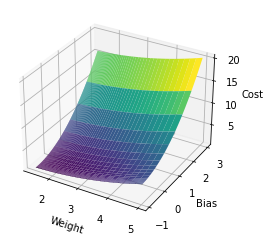

In [47]:
X, Y = np.meshgrid(w, b)

cost_value = cost(X, Y, x_gaussian, y_true_gaussian)[1]

fig = plt.figure()
ax = fig.add_subplot(projection = '3d')
#ax.contourf(X, Y, cost_value)
ax.set_xlabel('Weight')
ax.set_ylabel('Bias')
ax.set_zlabel('Cost')
ax.plot_surface(X, Y, cost_value, label="Loss surface", cmap='viridis',  edgecolor='none')
plt.show()

---

# Step 7: Add Regularization

In [48]:
def updateParams(w,b,X,Y,alpha,epochs,Lambda):
    cost_array = []
    w_array = []
    b_array = []
    for i in range(epochs):
        w_gradient_compute = alpha * (computeDeriv_dC_dw(w, b, X, Y) + w * Lambda)
        b_gradient_compute = alpha * (computeDeriv_dC_db(b, w, X, Y) + b * Lambda)

        w = w - w_gradient_compute
        b = b - b_gradient_compute

        cost_array.append(cost(w, b, X, Y)[1])
        w_array.append(w)
        b_array.append(b)
    return w_array, b_array, cost_array

In [49]:
w_true = 5
b_true = 3
w, b, c = updateParams(w_true, b_true, x_gaussian, y_true_gaussian,0.01,1000,1)

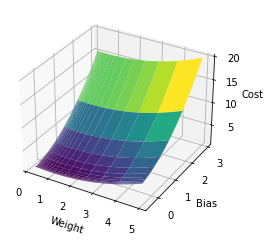

In [50]:
X, Y = np.meshgrid(w, b)

cost_value = cost(X, Y, x_gaussian, y_true_gaussian)[1]

fig = plt.figure()
ax = fig.add_subplot(projection = '3d')
#ax.contourf(X, Y, cost_value)
ax.set_xlabel('Weight')
ax.set_ylabel('Bias')
ax.set_zlabel('Cost')
ax.plot_surface(X, Y, cost_value, label="Loss surface", cmap='viridis',  edgecolor='none')
plt.show()

# Step 8: Non-linear data and Non-linear model!

(a) Import the dataset and make a plot of the dataset

In [51]:
import numpy as np

In [52]:
x, y =  np.load("dataset_cos.npy")

In [53]:
x = np.array(x)

In [54]:
y = np.array(y)

In [55]:
import matplotlib.pyplot as plt
%matplotlib inline 

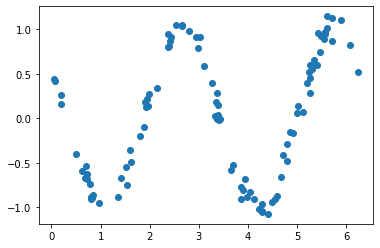

In [56]:
plt.scatter(x,y)

---

(b) Linear regression on the above dataset using gradient descent

In [57]:
def loss(w,b,x,ytrue,lossType):
    y_estimate = np.dot(w, x) + b
    if(lossType == 0):
        loss = y_estimate - ytrue
    elif(lossType == 1):
        loss = (y_estimate - ytrue)**2
    return loss

In [58]:
def cost(w,b,x,y):
    loss_absolute = 0
    loss_square = 0
    
    for i in range(n):
        loss_absolute = loss_absolute + loss(w,b,x[i],y[i],0)
        loss_square = loss_square + loss(w,b,x[i],y[i],1)
        
    return loss_absolute/n, loss_square/n

In [59]:
n = len(x)

In [60]:
w = 0
b = 0

alpha = 0.05 
epochs = 1000  

n = len(x) 

for i in range(epochs): 
    y_pred = np.dot(w, x) + b  
    D_w = (1/n) * sum(np.multiply(x, (y_pred - y)))  
    D_b = (1/n) * sum(y_pred - y)  
    w = w - alpha * D_w  
    b = b - alpha * D_b  
    
print (w, b)

0.12553571560080407 -0.39413441034034946


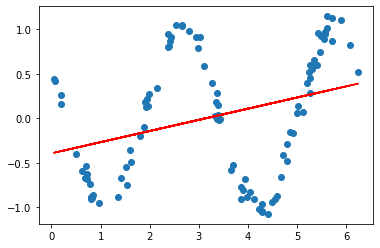

w -----> 0.12553571560080407
b -----> -0.39413441034034946
Cost -----> 0.4439248469287632


In [61]:
y_pred = w * x + b

plt.scatter(x, y) 
plt.plot(x, y_pred, color='red') 
plt.show()
costOutput = cost(w, b, x, y)[1]
print(f"w -----> {w}")
print(f"b -----> {b}")
print(f"Cost -----> {costOutput}")

In [62]:
n = 100

In [63]:
x1 = np.random.uniform(0,2*np.pi,100)

In [64]:
y1 = np.zeros(n)

In [65]:
y_pred = 0
c = ((y - y_pred) ** 2).sum()/n 
c

0.49270105464199476

<b> The cost is very close to the cost calculated from gradient descent, as the uniform distribution is from 0 - 2*pi, which is similar to that of cos graph. </b>

---

(c) Take the model to predict ypred= cos(w*x+b)

In [66]:
#Parameters Update Rules:

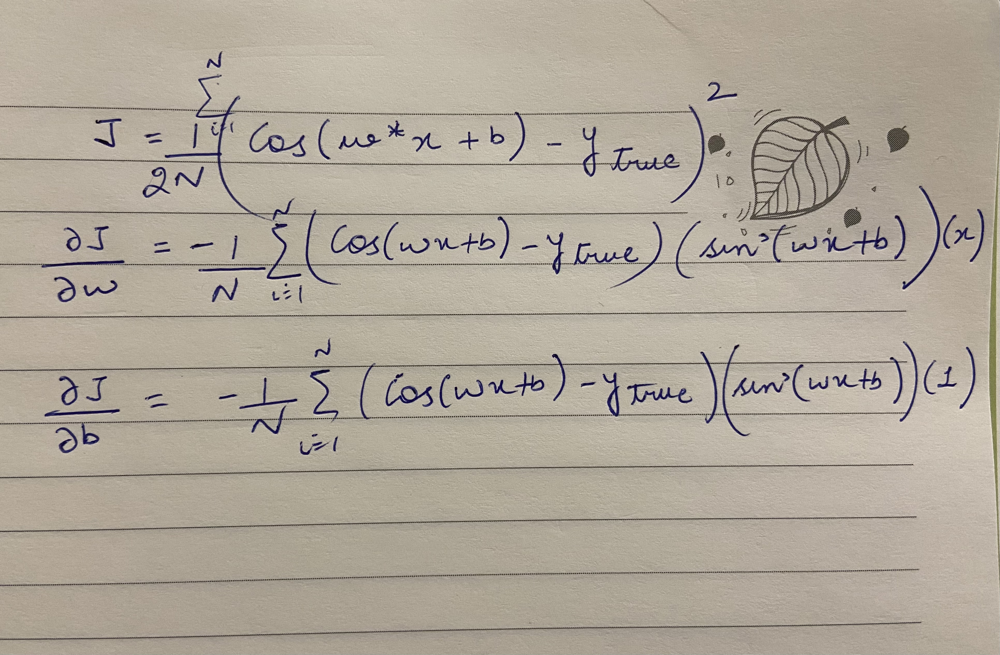

<b> 1. Getting the data for first element y[0], x[0]; creating an equation of w and b with x[0] and y[0] 
    2. Then, Getting the data for second element y[1], x[1]; creating an equation of w and b with x[1] and y[1]

3. Solving 2 equations to get value of w using cos inverse formula
4. Therefore, based on dataset provided, value calculated for w is around 2 as shown below </b>

In [67]:
w = (np.arccos(y[0]) + np.arccos(y[1]))/(x[1] + x[0])
w

2.0782035190219608

---

(d) Perform gradient descent using the model and update rules from step c)

In [68]:
def loss(w,b,x,ytrue,lossType):
    y_estimate = np.cos(w * x + b)
    if(lossType == 0):
        loss = y_estimate - ytrue
    elif(lossType == 1):
        loss = (y_estimate - ytrue)**2
    return loss

In [69]:
alpha = 0.05 
epochs = 1000 
n = len(x) 

In [70]:
def dw(n, x, y_pred, ytrue, w, b):
    return (-1/n) * sum(x * (y_pred - ytrue) * (np.sin(w * x + b)))

In [71]:
def db(n, x, y_pred, ytrue, w, b):
    return (-1/n) * sum(1 * (y_pred - ytrue) * (np.sin(w * x + b)))

In [72]:
def gradientDescent(x, y, alpha, epochs, n, w, b):

    for i in range(epochs): 
        y_pred = np.cos(w * x + b)
        D_w = dw(n, x, y_pred, y, w, b)
        D_b = db(n, x, y_pred, y, w, b)

        w = w - alpha * D_w  
        b = b - alpha * D_b
    
    return w, b

In [73]:
# (winitial=0.1,binitial=0.0)

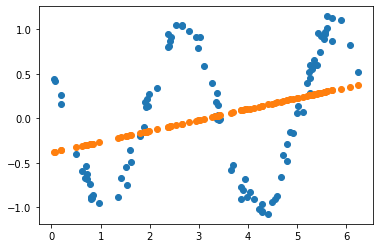

w -----> -0.12466817860037666
b -----> 1.9639791425845727
Cost -----> 0.4446118893077003


In [74]:
wTrue = 0.1
bTrue = 0
w, b = gradientDescent(x,y,alpha,epochs,n,wTrue,bTrue)

y_pred = np.cos(np.dot(w, x) + b)

plt.plot(x, y,'o') 
plt.plot(x, y_pred, 'o') 
plt.show()
costOutput = cost(w, b, x, y)[1]
print(f"w -----> {w}")
print(f"b -----> {b}")
print(f"Cost -----> {costOutput}")

In [75]:
# (winitial=0.5,binitial=0.0)

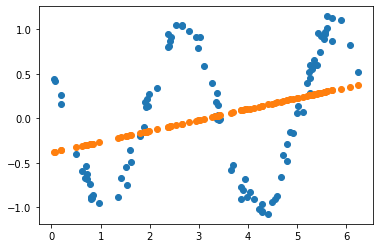

w -----> -0.12466407318522227
b -----> 1.9639617775220426
Cost -----> 0.4446118905349541


In [76]:
wTrue = 0.5
bTrue = 0
w, b = gradientDescent(x,y,alpha,epochs,n,wTrue,bTrue)

y_pred = np.cos(np.dot(w, x) + b)

plt.plot(x, y,'o') 
plt.plot(x, y_pred, 'o') 
plt.show()
costOutput = cost(w, b, x, y)[1]
print(f"w -----> {w}")
print(f"b -----> {b}")
print(f"Cost -----> {costOutput}")

In [77]:
# (winitial=1.5,binitial=0.0)

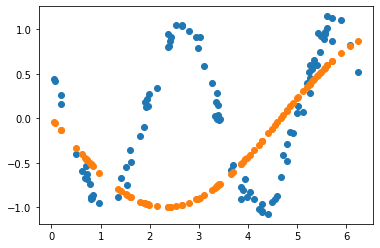

w -----> 0.6720706339335215
w -----> 1.5758278921823015
Cost -----> 0.7393814103853444


In [78]:
wTrue = 1.5
bTrue = 0
w, b = gradientDescent(x,y,alpha,epochs,n,wTrue,bTrue)

y_pred = np.cos(np.dot(w, x) + b)

plt.plot(x, y,'o') 
plt.plot(x, y_pred, 'o') 
plt.show()
costOutput = cost(w, b, x, y)[1]
print(f"w -----> {w}")
print(f"w -----> {b}")
print(f"Cost -----> {costOutput}")

In [79]:
# (winitial=1.9,binitial=0.0)

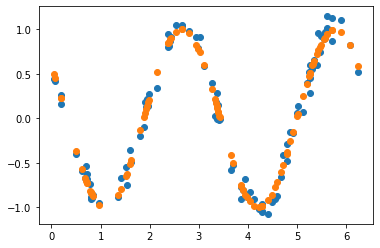

w -----> 2.009390605957101
b -----> 0.9504747887514231
Cost -----> 0.00866832036551535


In [80]:
wTrue = 1.9
bTrue = 0
w, b = gradientDescent(x,y,alpha,epochs,n,wTrue,bTrue)

y_pred = np.cos(np.dot(w, x) + b)

plt.plot(x, y,'o') 
plt.plot(x, y_pred, 'o') 
plt.show()
costOutput = cost(w, b, x, y)[1]
print(f"w -----> {w}")
print(f"b -----> {b}")
print(f"Cost -----> {costOutput}")

<b> As shown above in the four graphs, cost is close to 0.008 something after the fourth initialization.
    Cost is oscillating, first descreased, then increased, then decreased again with final cost of around 0.008
    </b>

---

(e) Implement gradient descent with momentum

In [81]:
def gradientDescentMomentum(x, y, alpha, epochs, n, w, b, momemtumFactor, m_w, m_b):

    for i in range(epochs): 
        y_pred = np.cos(w * x + b)
        D_w = (-1/n) * sum(x * (y_pred - y) * (np.sin(w * x + b)))
        D_b = (-1/n) * sum(1 * (y_pred - y) * (np.sin(w * x + b)))
        
        m_w = m_w * momemtumFactor + D_w
        m_b = m_b * momemtumFactor + D_b
        w = w - alpha * m_w 
        b = b - alpha * m_b 
    
    return w, b

In [82]:
# (winitial=0.1,binitial=0.0)

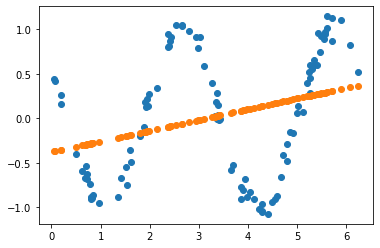

w -----> 0.12186102714506371
b -----> 4.3273532969307125
Cost -----> 0.44463724023572965


In [83]:
wTrue = 0.1
bTrue = 0
m = 0
momemtumFactor = 0.99
w, b = gradientDescentMomentum(x,y,alpha,epochs,n,wTrue,bTrue, momemtumFactor, 0, 0)

y_pred = np.cos(np.dot(w, x) + b)

plt.plot(x, y,'o') 
plt.plot(x, y_pred, 'o') 
plt.show()
costOutput = cost(w, b, x, y)[1]
print(f"w -----> {w}")
print(f"b -----> {b}")
print(f"Cost -----> {costOutput}")

In [84]:
# (winitial=0.5,binitial=0.0)

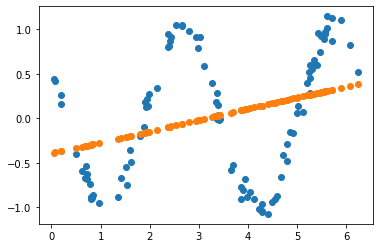

w -----> -0.12767171494847948
b -----> 1.974188089869558
Cost -----> 0.4446374851116861


In [85]:
wTrue = 0.5
bTrue = 0
m = 0
momemtumFactor = 0.99
w, b = gradientDescentMomentum(x,y,alpha,epochs,n,wTrue,bTrue, momemtumFactor, 0, 0)

y_pred = np.cos(np.dot(w, x) + b)

plt.plot(x, y,'o') 
plt.plot(x, y_pred, 'o') 
plt.show()
costOutput = cost(w, b, x, y)[1]
print(f"w -----> {w}")
print(f"b -----> {b}")
print(f"Cost -----> {costOutput}")

In [86]:
# (winitial=1.5,binitial=0.0)

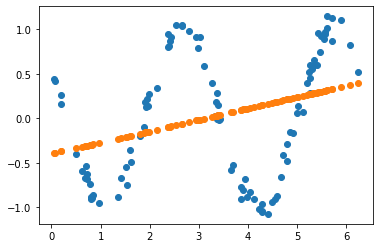

w -----> -0.1294597134838828
b -----> 1.9766527701815504
Cost -----> 0.444689812554808


In [87]:
wTrue = 1.5
bTrue = 0
m = 0
momemtumFactor = 0.99
w, b = gradientDescentMomentum(x,y,alpha,epochs,n,wTrue,bTrue, momemtumFactor, 0, 0)

y_pred = np.cos(np.dot(w, x) + b)

plt.plot(x, y,'o') 
plt.plot(x, y_pred, 'o') 
plt.show()
costOutput = cost(w, b, x, y)[1]
print(f"w -----> {w}")
print(f"b -----> {b}")
print(f"Cost -----> {costOutput}")

In [88]:
# (winitial=1.9,binitial=0.0)

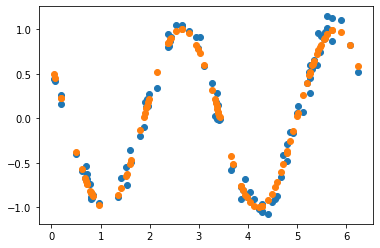

w -----> 2.0104967070931807
b -----> 0.9518932504820035
Cost -----> 0.008682899040031717


In [89]:
wTrue = 1.9
bTrue = 0
m = 0
momemtumFactor = 0.99
w, b = gradientDescentMomentum(x,y,alpha,epochs,n,wTrue,bTrue, momemtumFactor, 0, 0)

y_pred = np.cos(np.dot(w, x) + b)

plt.plot(x, y,'o') 
plt.plot(x, y_pred, 'o') 
plt.show()
costOutput = cost(w, b, x, y)[1]
print(f"w -----> {w}")
print(f"b -----> {b}")
print(f"Cost -----> {costOutput}")

<b> Yes, convergence is more for more initializations, as there is prevention of oscillations due to momentum factor and cost decreased to reach around zero. </b>

---

(f) Stochastic Gradient Descent

In [90]:
n = len(x)

In [91]:
def stochasticGradientDescent(x, y, alpha, epochs, n, w, b):

    for i in range(epochs): 
        for j in range(len(x)):
            y_pred = np.cos(w * x[j] + b)
            D_w = -2 * (x[j] * (y_pred - y[j]) * (np.sin(w * x[j] + b)))
            D_b = -2 * (1 * (y_pred - y[j]) * (np.sin(w * x[j] + b)))

            w = w - alpha * D_w  
            b = b - alpha * D_b

    
    return w, b

In [92]:
# (winitial=0.1,binitial=0.0)

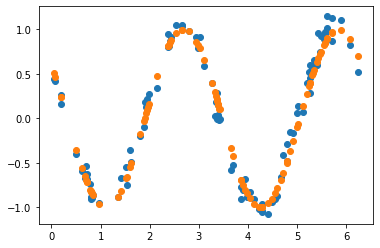

w -----> 1.9873106697237668
b -----> 0.9448510210112695
Cost -----> 0.012717275646155572


In [93]:
w = 0.1
b = 0

w, b = stochasticGradientDescent(x, y, alpha, 1000, n, w, b)
y_pred = np.cos(np.dot(w, x) + b)

plt.plot(x, y,'o') 
plt.plot(x, y_pred, 'o') 
plt.show()
costOutput = cost(w, b, x, y)[1]
print(f"w -----> {w}")
print(f"b -----> {b}")
print(f"Cost -----> {costOutput}")

In [94]:
# (winitial=0.5,binitial=0.0)

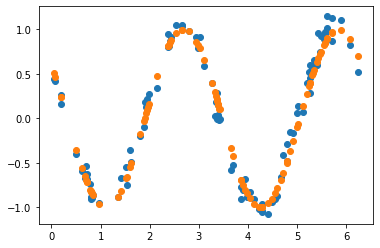

w -----> 1.9873106697237668
b -----> 0.9448510210112695
Cost -----> 0.012717275646155572


In [95]:
w = 0.5
b = 0

w, b = stochasticGradientDescent(x, y, alpha, 1000, n, w, b)
y_pred = np.cos(np.dot(w, x) + b)

plt.plot(x, y,'o') 
plt.plot(x, y_pred, 'o') 
plt.show()
costOutput = cost(w, b, x, y)[1]
print(f"w -----> {w}")
print(f"b -----> {b}")
print(f"Cost -----> {costOutput}")

In [96]:
# (winitial=1.5,binitial=0.0)

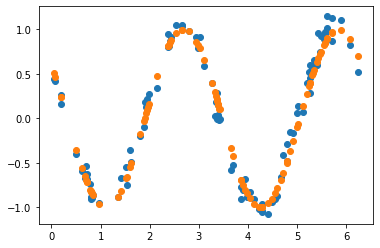

w -----> 1.9873106697237668
b -----> 0.9448510210112695
Cost -----> 0.012717275646155572


In [97]:
w = 1.5
b = 0

w, b = stochasticGradientDescent(x, y, alpha, 1000, n, w, b)
y_pred = np.cos(np.dot(w, x) + b)

plt.plot(x, y,'o') 
plt.plot(x, y_pred, 'o') 
plt.show()
costOutput = cost(w, b, x, y)[1]
print(f"w -----> {w}")
print(f"b -----> {b}")
print(f"Cost -----> {costOutput}")

In [98]:
# (winitial=1.9,binitial=0.0)

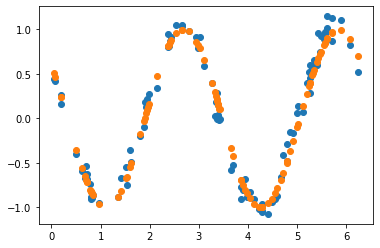

w -----> 1.9873106697237668
b -----> 0.9448510210112695
Cost -----> 0.012717275646155572


In [99]:
w = 1.9
b = 0

w, b = stochasticGradientDescent(x, y, alpha, 1000, n, w, b)
y_pred = np.cos(np.dot(w, x) + b)

plt.plot(x, y,'o') 
plt.plot(x, y_pred, 'o') 
plt.show()
costOutput = cost(w, b, x, y)[1]
print(f"w -----> {w}")
print(f"b -----> {b}")
print(f"Cost -----> {costOutput}")

<b> Yes, the above stochastic gradient descent method improves convergence for more initializations as stability can be seen in the cost for those initializations and oscillations are prevented. </b>

---

(g) Stochastic Gradient Descent with Momentum

In [100]:
def stochasticGradientDescentMomentum(x, y, alpha, epochs, n, w, b, momemtumFactor, m_w, m_b):

    for i in range(epochs): 
        for j in range(len(x)):
            y_pred = np.cos(w * x[j] + b)
            D_w = -2 * (x[j] * (y_pred - y[j]) * (np.sin(w * x[j] + b)))
            D_b = -2 * (1 * (y_pred - y[j]) * (np.sin(w * x[j] + b)))

            m_w = m_w * momemtumFactor + D_w
            m_b = m_b * momemtumFactor + D_b
            w = w - alpha * m_w 
            b = b - alpha * m_b 

    
    return w, b

In [101]:
# (winitial=0.1,binitial=0.0)

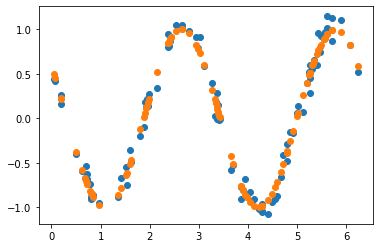

w -----> 2.0093112961586335
b -----> 0.9568136471255413
Cost -----> 0.008683985982569652


In [102]:
wTrue = 0.1
bTrue = 0
m = 0
momemtumFactor = 0.99
w, b = stochasticGradientDescentMomentum(x,y,0.0005,1000,n,wTrue,bTrue, momemtumFactor, 0, 0)

y_pred = np.cos(np.dot(w, x) + b)

plt.plot(x, y, 'o') 
plt.plot(x, y_pred, 'o') 
plt.show()
costOutput = cost(w, b, x, y)[1]
print(f"w -----> {w}")
print(f"b -----> {b}")
print(f"Cost -----> {costOutput}")

In [103]:
# (winitial=0.5,binitial=0.0)

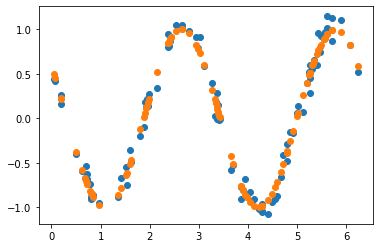

w -----> 2.0093112961586352
b -----> 0.9568136471255416
Cost -----> 0.00868398598256969


In [104]:
wTrue = 0.5
bTrue = 0
m = 0
momemtumFactor = 0.99
w, b = stochasticGradientDescentMomentum(x,y,0.0005,1000,n,wTrue,bTrue, momemtumFactor, 0, 0)

y_pred = np.cos(np.dot(w, x) + b)

plt.plot(x, y, 'o') 
plt.plot(x, y_pred, 'o') 
plt.show()
costOutput = cost(w, b, x, y)[1]
print(f"w -----> {w}")
print(f"b -----> {b}")
print(f"Cost -----> {costOutput}")

In [105]:
# (winitial=1.5,binitial=0.0)

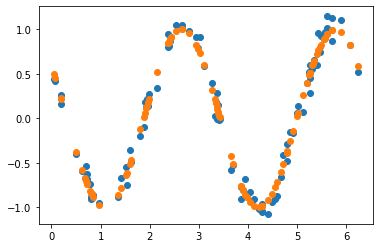

w -----> 2.0093112961586352
b -----> 0.9568136471255416
Cost -----> 0.00868398598256969


In [106]:
wTrue = 1.5
bTrue = 0
m = 0
momemtumFactor = 0.99
w, b = stochasticGradientDescentMomentum(x,y,0.0005,1000,n,wTrue,bTrue, momemtumFactor, 0, 0)

y_pred = np.cos(np.dot(w, x) + b)

plt.plot(x, y, 'o') 
plt.plot(x, y_pred, 'o') 
plt.show()
costOutput = cost(w, b, x, y)[1]
print(f"w -----> {w}")
print(f"b -----> {b}")
print(f"Cost -----> {costOutput}")

In [107]:
# (winitial=1.9,binitial=0.0)

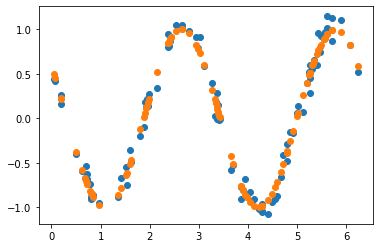

w -----> 2.0093112961586335
b -----> 0.9568136471255413
Cost -----> 0.008683985982569652


In [108]:
wTrue = 1.9
bTrue = 0
m = 0
momemtumFactor = 0.99
w, b = stochasticGradientDescentMomentum(x,y,0.0005,1000,n,wTrue,bTrue, momemtumFactor, 0, 0)

y_pred = np.cos(np.dot(w, x) + b)

plt.plot(x, y, 'o') 
plt.plot(x, y_pred, 'o') 
plt.show()
costOutput = cost(w, b, x, y)[1]
print(f"w -----> {w}")
print(f"b -----> {b}")
print(f"Cost -----> {costOutput}")

In [109]:
#Momentum factor = 0.0005

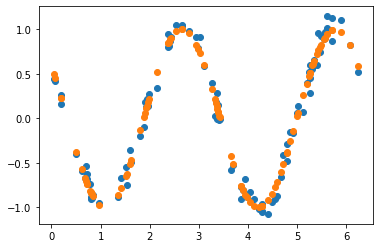

w -----> 2.0097307587385917
b -----> 0.9534362754584843
Cost -----> 0.008675455005276606


In [110]:
wTrue = 1.9
bTrue = 0
m = 0
momemtumFactor = 0.0005
w, b = stochasticGradientDescentMomentum(x,y,0.0005,1000,n,wTrue,bTrue, momemtumFactor, 0, 0)

y_pred = np.cos(np.dot(w, x) + b)

plt.plot(x, y, 'o') 
plt.plot(x, y_pred, 'o') 
plt.show()
costOutput = cost(w, b, x, y)[1]
print(f"w -----> {w}")
print(f"b -----> {b}")
print(f"Cost -----> {costOutput}")

<b> Yes, managed to converge to better minimums, w and b are closer to the true values of w and b as shown above
Also, with less momemtum factor, values of w and b are improved and more closer to true values of w and b </b>

---

(h) If you found that convergence improved in e), f), and/or g) can you offer an explanation as to why this probably happened in each case?

<b> Yes, convergence gradually improved in step g, because momemtum and at each step derivative, oscillations descreased and stability achieved. So, optimized pointand global minima is reached.
i.e., Stochastic Gradient descent acelerates gradient vectors in the right direction. </b>

# References